In [2]:
import cv2
import matplotlib.pyplot as plt

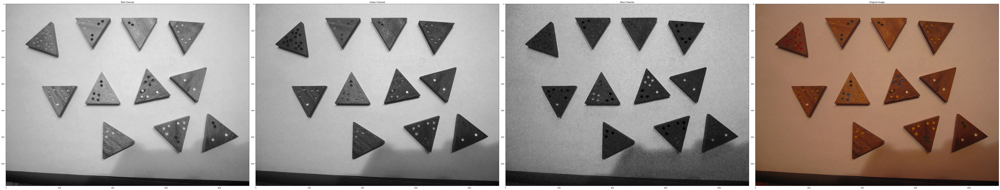

In [3]:
image = cv2.imread('data/Pict_1_1.bmp')
# image to numpy array
red_channel = image[:, :, 2]
green_channel = image[:, :, 1]
blue_channel = image[:, :, 0]

plt.figure(figsize=(80, 20))
# Display the red channel
plt.subplot(1, 4, 1)
plt.imshow(red_channel, cmap='gray')
plt.title('Red Channel')

# Display the green channel
plt.subplot(1, 4, 2)
plt.imshow(green_channel, cmap='gray')
plt.title('Green Channel')

# Display the blue channel
plt.subplot(1, 4, 3)
plt.imshow(blue_channel, cmap='gray')
plt.title('Blue Channel')

# Display the original image
plt.subplot(1, 4, 4)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

# Adjust the layout
plt.tight_layout()
plt.show()



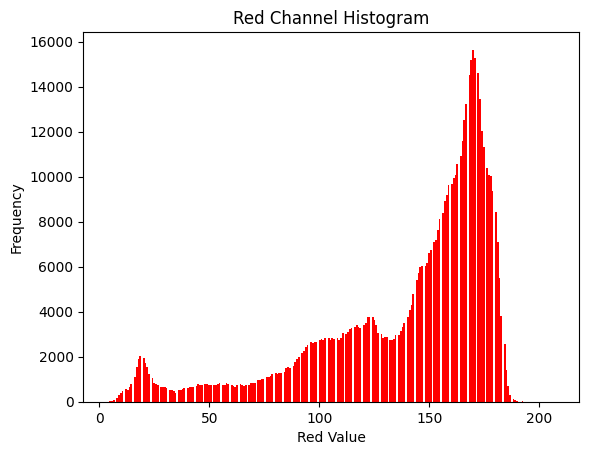

In [4]:
# experiments with red channel
red_channel_values = red_channel.flatten()
plt.hist(red_channel_values, bins=256, color='red')
plt.title('Red Channel Histogram')
plt.xlabel('Red Value')
plt.ylabel('Frequency')
plt.show()

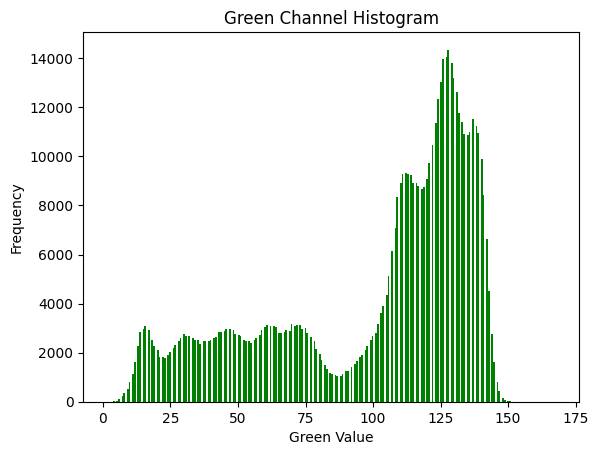

In [5]:
green_channel_values = green_channel.flatten()
plt.hist(green_channel_values, bins=256, color='green')
plt.title('Green Channel Histogram')
plt.xlabel('Green Value')
plt.ylabel('Frequency')
plt.show()

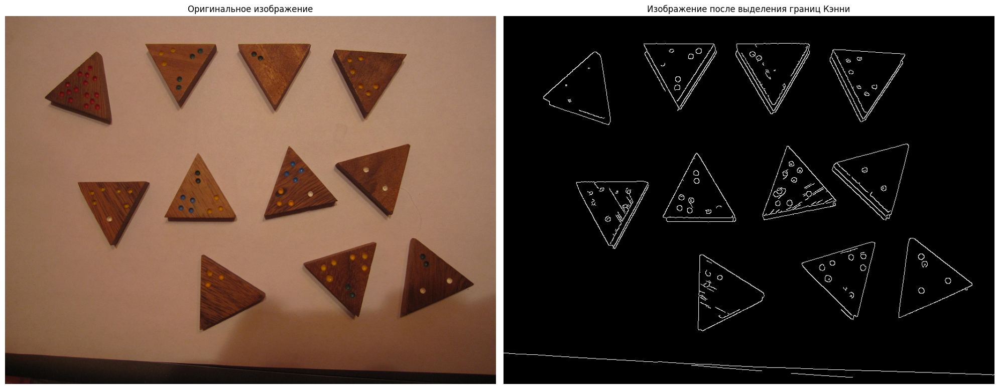

In [9]:
# experiments with Canny
edges = cv2.Canny(image, 100, 200)
# show both pictures - original and after edges
plt.figure(figsize=(20, 10))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Оригинальное изображение')
plt.axis('off')
plt.subplot(1, 2, 2)
plt.imshow(edges, cmap='gray')
plt.title('Изображение после выделения границ Кэнни')
plt.axis('off')
plt.tight_layout()

# save plt picture
plt.savefig('data/canny_exp.png')


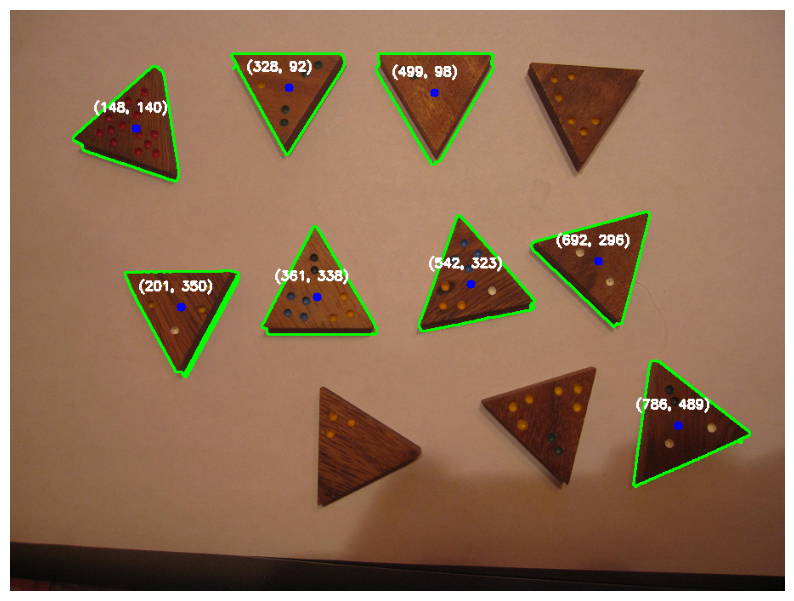

In [22]:
image = cv2.imread('data/Pict_1_1.bmp')

gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray_image, 100, 200)

# Нахождение контуров
contours, _ = cv2.findContours(
    edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Создание копии изображения для рисования контуров и центров
result_image = image.copy()

# Поиск треугольных контуров
for contour in contours:
    # Аппроксимация контура полигоном
    approx = cv2.approxPolyDP(
        contour, 0.03 * cv2.arcLength(contour, True), True)
    # Проверка, является ли полигон треугольником (три вершины)
    if len(approx) == 3:
        # Рисование контура на изображении
        cv2.drawContours(result_image, [contour], -1, (0, 255, 0), 2)

        # Вычисление центра масс контура
        M = cv2.moments(contour)
        if M["m00"] != 0:
            cX = int(M["m10"] / M["m00"])
            cY = int(M["m01"] / M["m00"])
            # Рисование центра треугольника
            cv2.circle(result_image, (cX, cY), 5, (255, 0, 0), -1)
            # Подпись координат центра на изображении
            cv2.putText(result_image, f"({cX}, {cY})", (cX - 50, cY - 20),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

# Отображение изображения с контурами и центрами
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.savefig('data/triangle.png')

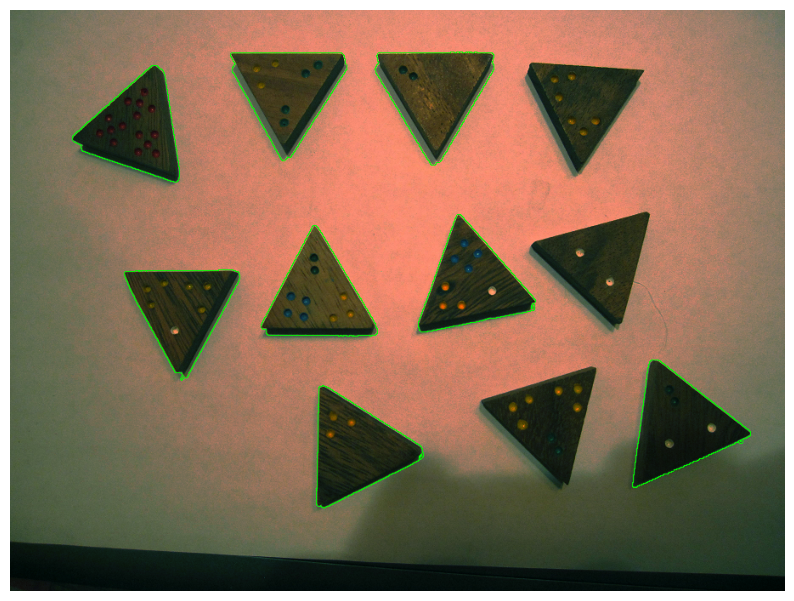

In [14]:
import numpy as np

# Преобразование изображения в оттенки серого
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray_image, 100, 200)

# Нахождение контуров
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL,
                                cv2.CHAIN_APPROX_SIMPLE)

# Создание маски для фона
mask = np.zeros_like(gray_image)

# Создание копии изображения для рисования контуров
contour_image = image.copy()

# Поиск треугольных контуров и создание маски для них
for contour in contours:
    # Аппроксимация контура полигоном
    approx = cv2.approxPolyDP(
        contour, 0.03 * cv2.arcLength(contour, True), True)
    # Проверка, является ли полигон треугольником (три вершины)
    if len(approx) == 3:
        # Рисование контура на изображении
        cv2.drawContours(contour_image, [contour], -1, (0, 255, 0), 2)
        # Создание маски для треугольных контуров
        cv2.drawContours(mask, [contour], -1, 255, -1)

# Замена фона на белый цвет везде, кроме областей,
#  найденных треугольников
background = cv2.bitwise_not(mask)
result_image = cv2.bitwise_and(cv2.merge(
    [background]*3), contour_image) + \
    cv2.bitwise_and(cv2.merge([mask] * 3), image)


# Отображение изображения с контурами и центрами
plt.figure(figsize=(10, 10))
plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

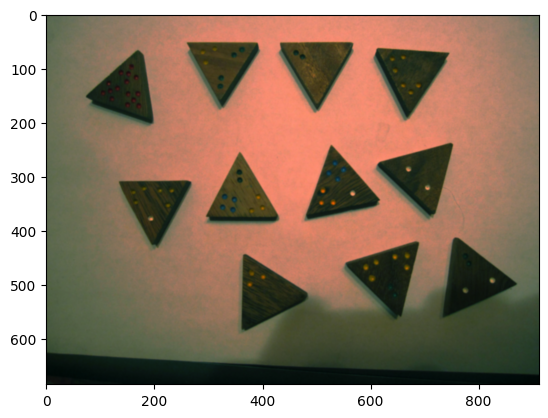

In [20]:
image = cv2.imread('data/Pict_1_1.bmp')
# high red channel values
red_channel = image[:, :, 2]
# contrasrt
red_channel = cv2.equalizeHist(red_channel)
# show red channel
image[:, :, 2] = red_channel
# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

# gauss filter to exist image
image = cv2.GaussianBlur(image, (5, 5), 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))


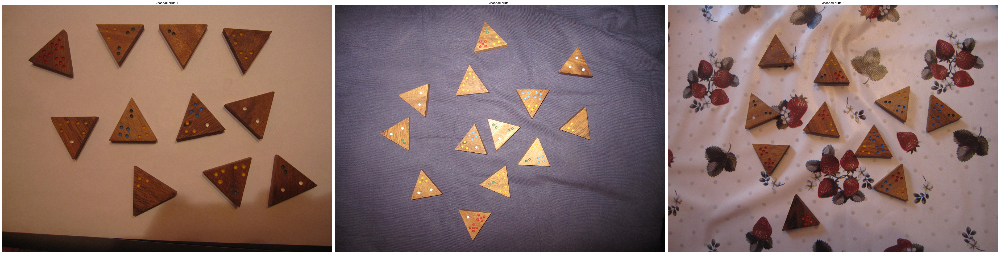

In [23]:
image1 = cv2.imread('data/Pict_1_1.bmp')
image2 = cv2.imread('data/Pict_2_1.bmp')
image3 = cv2.imread('data/Pict_3_1.bmp')

# Вывести
plt.figure(figsize=(60, 20))
plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(image2, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(image3, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.tight_layout()
plt.savefig('data/3_images.png')